# Hospitality Data EDA

In [11]:
# Imports
import pandas as pd
import numpy as np 
import re
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as py  
import plotly.graph_objs as go  
import cufflinks as cf
import colorlover as cl

from IPython.display import HTML
from bs4 import BeautifulSoup
from urllib.request import urlopen
from scrapy.selector import Selector
from scrapy.http import HtmlResponse
from yahoo_finance import Share
from IPython.display import Image
from datetime import datetime
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import acf
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import pacf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.arima_model import ARMA

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

sns.set_style('whitegrid')
py.init_notebook_mode()  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


## Functions 

In [12]:
def find_industry(tick):
    """Using the Ticker Symbol of any given US Stock, find the assiocaited industry. We do this by web scraping 
    Yahoo Finance."""
    stock_url = 'https://finance.yahoo.com/quote/'+tick+'/profile?p='+tick
    stock_page = requests.get(stock_url)
    stock_soup = BeautifulSoup(stock_page.content,'lxml')
    industry_text = stock_soup.body.find('div', attrs={'class':'asset-profile-container'})
    industry_text_clean = str(industry_text.select('strong')[0])
    p = re.compile('(?<=\>)(.*)(?=<)')
    m = p.search(industry_text_clean)
    return m.group()
    
def ticker_to_name(tick):
    """Using the Ticker Symbol of any given US Stock, find the complete company name. We do this by web scraping 
    Yahoo Finance."""
    stock_url = 'https://finance.yahoo.com/quote/'+tick+'/profile?p='+tick
    stock_page = requests.get(stock_url)
    stock_soup = BeautifulSoup(stock_page.content,'lxml')
    company_text = stock_soup.find("div",attrs={'class':'asset-profile-container'})
    company_text_clean = str(company_text.select('h3'))
    p = re.compile('(?<=\>)(.*)(?=<)')
    m = p.search(company_text_clean)
    return m.group()

# A gift from Adam
def hosp_dummify(col,target,df): 
    """Create dummy columns with my target obvservation as the dummy value"""
    lsting = {}
    for index, row in df.groupby(["Date",col]).sum().iterrows():
        if index[0] in lsting:
            if index[1] in lsting[index[0]]:
                lsting[index[0]][index[1]] += row[target]
            else:
                lsting[index[0]].update({index[1]:row[target]})
        else:
            lsting[index[0]] = {index[1]:row[target]}
    return pd.DataFrame.from_dict(lsting, orient="index")

#### Test the above functions below

In [13]:
print(ticker_to_name('AAL'))
print(find_industry('AAL'))

American Airlines Group Inc.
Services


## Hospitality Companies to Look at 

We will be conducting an exploratory data analyissi in the historical stock performance of the following companies

**Airlines: **
1. American Airlines Group, Inc. (AAL)
2. Delta Air Lines, Inc. (DAL)
3. Southwest Airlines Company (LUV)
4. United Continental Holdings, Inc. (UAL)

**Cruise Ships: **
1. Carnival Corporation (CCL)
2. Norwegian Cruise Line Holdings Ltd. (NCLH)
3. Royal Caribbean Cruises Ltd. (RCL)

**Hotels: **
1. Hilton Worldwide Holdings Inc. (HLT)
2. Intercontinental Hotels Group (IHG)
3. Marriott International (MAR)
4. Wyndham Worldwide Corp (WYN)

In [14]:
airlines = ['AAL', 'LUV', 'UAL' ] # Deleted Delta 'DAL'
cruise_ship = ['CCL', 'NCLH', 'RCL']
hotels = ['HLT', 'IHG', 'MAR', 'WYN']

hospitality_industry = ['AAL', 'LUV', 'UAL','CCL', 'NCLH', 'RCL','HLT', 'IHG', 'MAR', 'WYN']# Deleted Delta 'DAL'

hospitality = pd.DataFrame(columns=['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 
                                    'OpenInt','Company industry','Company name','Categories'])

for newdf in hospitality_industry:
    if newdf in airlines: 
        df = pd.read_csv(newdf+'.us.txt')
        df['Company industry']  = find_industry(newdf)
        df['Company name'] = ticker_to_name(newdf)
        df['Categories'] = "Airlines"
        
        hospitality = pd.concat([hospitality, df], ignore_index=True)

    elif newdf in cruise_ship: 
        df = pd.read_csv(newdf+'.us.txt')
        df['Company industry']  = find_industry(newdf)
        df['Company name'] =  ticker_to_name(newdf)
        df['Categories'] = "Cruise Ships"
        hospitality = pd.concat([hospitality, df], ignore_index=True)

    elif newdf in hotels:
        df = pd.read_csv(newdf+'.us.txt')
        df['Company industry']  = find_industry(newdf)
        df['Company name'] =  ticker_to_name(newdf)
        df['Categories'] = "Hotels"
        hospitality = pd.concat([hospitality, df], ignore_index=True)
             
        

In [15]:
#Feature Gives us no information, all 0's
hospitality.drop('OpenInt',inplace=True, axis = 1) 

# Make the Volume Feature Numeric 
hospitality['Volume'] =  hospitality[['Volume']].apply(pd.to_numeric)

# Make a Date a Datetime object 
hospitality['Date'] = pd.to_datetime(hospitality.Date)

In [16]:
hospitality.sort_values(by='Date', inplace=True)

In [17]:
hospitality

,Date,Open,High,Low,Close,Volume,Company industry,Company name,Categories
989,1980-01-02,0.18229,0.18229,0.18229,0.18229,845863,Services,Southwest Airlines Co.,Airlines
990,1980-01-03,0.18229,0.18229,0.17271,0.17271,567617,Services,Southwest Airlines Co.,Airlines
991,1980-01-04,0.17271,0.18229,0.17271,0.18229,322764,Services,Southwest Airlines Co.,Airlines
992,1980-01-07,0.18229,0.18229,0.17271,0.17271,701177,Services,Southwest Airlines Co.,Airlines
993,1980-01-08,0.17271,0.18229,0.16301,0.17271,901510,Services,Southwest Airlines Co.,Airlines
994,1980-01-09,0.17271,0.17271,0.16301,0.16301,333893,Services,Southwest Airlines Co.,Airlines
995,1980-01-10,0.16301,0.17271,0.16301,0.17271,979416,Services,Southwest Airlines Co.,Airlines
996,1980-01-11,0.17271,0.17271,0.17271,0.17271,879252,Services,Southwest Airlines Co.,Airlines
997,1980-01-14,0.17271,0.17271,0.16301,0.17271,1335572,Services,Southwest Airlines Co.,Airlines
998,1980-01-15,0.17271,0.18229,0.17271,0.17271,1613816,Services,Southwest Airlines Co.,Airlines


## EDA on Hospitality DataSet by Industry

In [18]:
hospitality=hospitality.reindex()

In [19]:
lsting = {}
for index, row in hospitality.groupby(["Date","Company industry"]).mean().iterrows():
    if index[0] in lsting:
        if index[1] in lsting[index[0]]:
            lsting[index[0]][index[1]] += row['Open']
        else:
            lsting[index[0]].update({index[1]:row['Open']})
    else:
        lsting[index[0]] = {index[1]:row['Open']}
hos_close = pd.DataFrame.from_dict(lsting, orient="index")
hos_close.fillna(0,inplace=True)
hos_close.head(1)

lsting = {}
for index, row in hospitality.groupby(["Date","Company industry"]).mean().iterrows():
    if index[0] in lsting:
        if index[1] in lsting[index[0]]:
            lsting[index[0]][index[1]] += row['Volume']
        else:
            lsting[index[0]].update({index[1]:row['Volume']})
    else:
        lsting[index[0]] = {index[1]:row['Volume']}
hos_volume = pd.DataFrame.from_dict(lsting, orient="index")
hos_volume.fillna(0,inplace=True)
hos_volume.drop(hos_volume.columns[1], axis=1, inplace=True)
hos_volume.columns = ['Industry Volume']

In [20]:
 yaxis=dict(title='Unadjusted Stock $ Value')  

In [21]:
Industry = go.Scatter(
                x=hos_close.index,
                y=hos_close.Services,
                name = "Industry",
                line = dict(color = '#FFD700', shape='spline'),
                opacity = 0.8)


data = [Industry]


layout = dict(
    title='Industry Mean Stock Price ',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1Y',
                     step= 'month',
                    stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
     yaxis=dict(title='Unadjusted Stock $ Value')  
)

fig = dict(data=data, layout=layout)
py.iplot(fig)

In [22]:
Industry = go.Scatter(
                x=industry_volume.index,
                y=industry_volume['Industry Volume'],
                name = "Industry",
                line = dict(color = '#f032e8', shape='spline'),
                #line = dict(),
                opacity = 0.8)


data = [Industry]


layout = dict(
    title='Volume Traded ',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1Y',
                     step= 'month',
                    stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
     yaxis=dict(title='Hospitality Industry')  
)

fig = dict(data=data, layout=layout)
py.iplot(fig)

NameError: name 'industry_volume' is not defined

## EDA on Hospitality DataSet by Category

In [23]:
hospitality=hospitality.reindex()

In [24]:
lsting = {}
for index, row in hospitality.groupby(["Date","Categories"]).mean().iterrows():
    if index[0] in lsting:
        if index[1] in lsting[index[0]]:
            lsting[index[0]][index[1]] += row['Open']
        else:
            lsting[index[0]].update({index[1]:row['Open']})
    else:
        lsting[index[0]] = {index[1]:row['Open']}
industry_close = pd.DataFrame.from_dict(lsting, orient="index")
industry_close.fillna(0,inplace=True)
industry_close

lsting = {}
for index, row in hospitality.groupby(["Date","Categories"]).mean().iterrows():
    if index[0] in lsting:
        if index[1] in lsting[index[0]]:
            lsting[index[0]][index[1]] += row['Volume']
        else:
            lsting[index[0]].update({index[1]:row['Volume']})
    else:
        lsting[index[0]] = {index[1]:row['Volume']}
cat_volume = pd.DataFrame.from_dict(lsting, orient="index")
cat_volume.fillna(0,inplace=True)
cat_volume.columns = ['Airlines Volume','Cruise Ships Volume','Hotels Volume']

In [28]:
Airlines = go.Scatter(
                x=industry_close.index,
                y=industry_close.Airlines,
                name = "Airlines",
                line = dict(color = '#f032e6'),
                opacity = 0.8)

Cruise_Ships = go.Scatter(
                x=industry_close.index,
                y=industry_close['Cruise Ships'],
                name = "Cruise",
                line = dict(color = '#7F7F7F'),
                opacity = 0.8)

Hotels = go.Scatter(
                x=industry_close.index,
                y=industry_close.Hotels,
                name = "Hotels",
                line = dict(color = '#17BECF'),
                opacity = 0.8)


data = [Cruise_Ships, Hotels, Airlines]


layout = dict(
    title='Mean Historical Closing Price Looked at by Tourism Verticle',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1Y',
                     step= 'month',
                    stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
     yaxis=dict(title='Unadjusted Stock $ Value')  
)

fig = dict(data=data, layout=layout)
py.iplot(fig)

In [26]:
Airlines = go.Scatter(
                x=cat_volume.index,
                y=cat_volume['Airlines Volume'],
                name = "Airlines",
                line = dict(color = '#f032e6'),
                opacity = 0.8)

Cruise_Ships = go.Scatter(
                x=cat_volume.index,
                y=cat_volume['Cruise Ships Volume'],
                name = "Cruise",
                line = dict(color = '#7F7F7F'),
                opacity = 0.8)

Hotels = go.Scatter(
                x=cat_volume.index,
                y=cat_volume['Hotels Volume'],
                name = "Hotels",
                line = dict(color = '#17BECF'),
                opacity = 0.8)


data = [Cruise_Ships, Hotels, Airlines]


layout = dict(
    title='Mean Historical Stock Prices Looked at by Verticle',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1Y',
                     step= 'month',
                    stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
     yaxis=dict(title='Unadjusted Stock $ Value')  
)

fig = dict(data=data, layout=layout)
py.iplot(fig)

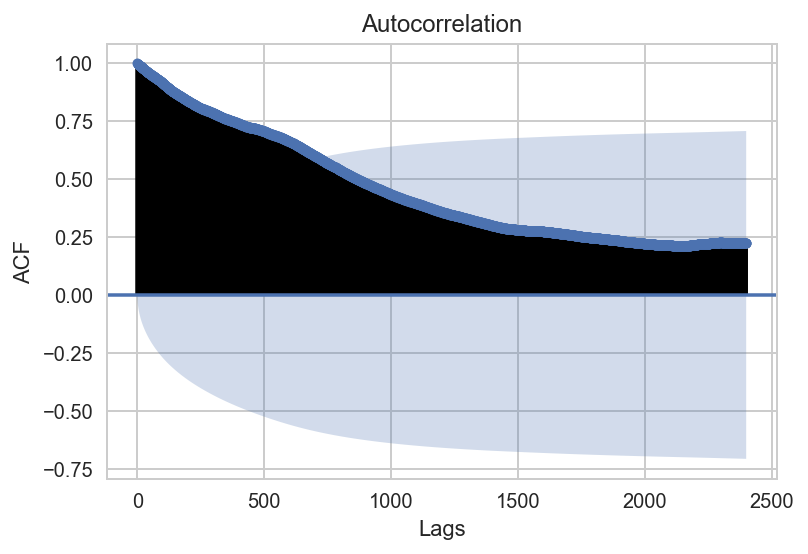

In [27]:
#fig, ax = plt.figure(figsize=(12,8))
plot_acf(industry_close.Hotels, lags=2400, zero=False );
plt.xlabel('Lags')
plt.ylabel('ACF')

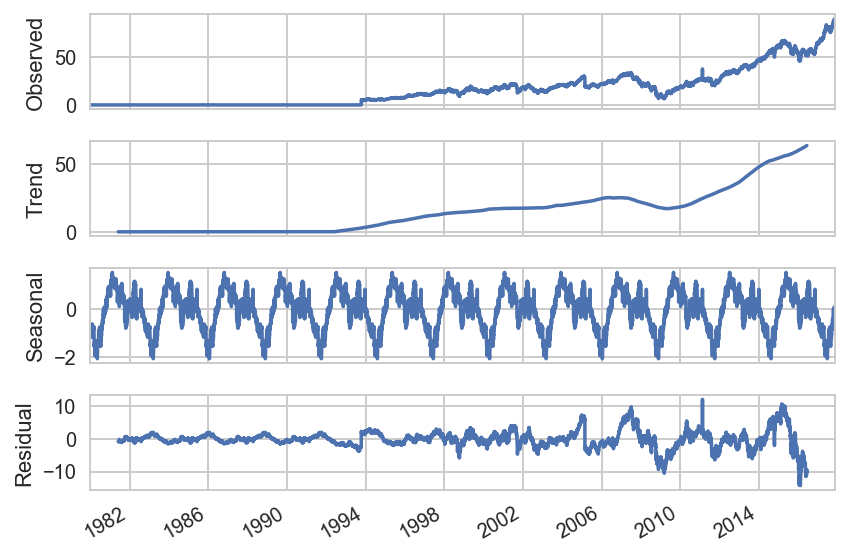

In [20]:
result = seasonal_decompose(industry_close.Hotels, freq=720)
result.plot()
plt.show()

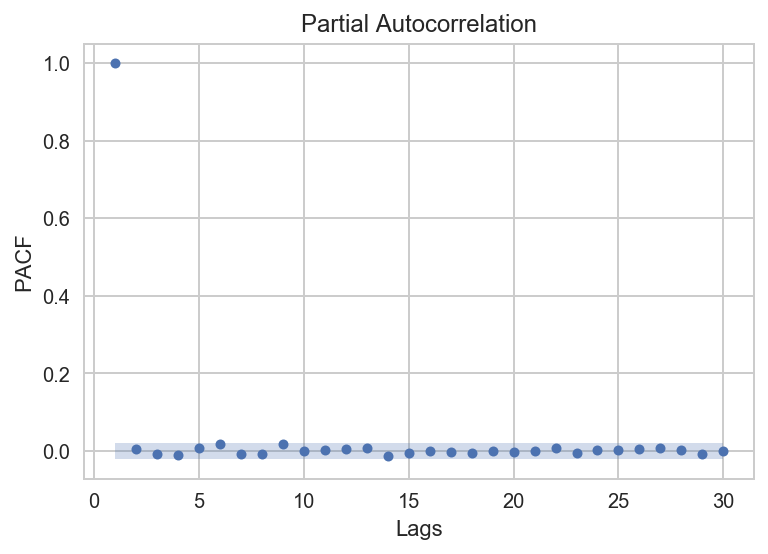

In [408]:
#fig, ax = plt.figure(figsize=(12,8))
plot_pacf(industry_close.Hotels, lags=30,use_vlines=False, zero=False);
plt.xlabel('Lags')
plt.ylabel('PACF')

## EDA on Hospitality DataSet by Company 

In [86]:
company_close = hosp_dummify(hospitality['Company name'],'Close',hospitality)
company_close.fillna(0,inplace=True)
company_close.head(1)


lsting = {}
for index, row in hospitality.groupby(["Date","Company name"]).mean().iterrows():
    if index[0] in lsting:
        if index[1] in lsting[index[0]]:
            lsting[index[0]][index[1]] += row['Volume']
        else:
            lsting[index[0]].update({index[1]:row['Volume']})
    else:
        lsting[index[0]] = {index[1]:row['Volume']}
company_volume = pd.DataFrame.from_dict(lsting, orient="index")
company_volume.fillna(0,inplace=True)
company_volume.columns = ['Delta Air Lines, Inc. Volume',
                           'Southwest Airlines Co. Volume',
                           'Carnival Corporation Volume',
                           'Marriott International, Inc. Volume',
                           'InterContinental Hotels Group PLC Volume',
                           'Royal Caribbean Volume',
                           'United Continental Holdings, Inc. Volume',
                           'Wyndham Worldwide Corporation Volume',
                           'Norwegian Cruise Line Holdings Ltd. Volume',
                           'American Airlines Group Inc. Volume',
                           'Hilton Worldwide Holdings Inc. Volume',]

In [87]:
DAL = go.Scatter(
                x=company_close.index,
                y=company_close['Delta Air Lines, Inc.'],
                name = "Delta Air Lines",
                line = dict(color = '#e6194b'),
                opacity = 0.8)

SAA = go.Scatter(
                x=company_close.index,
                y=company_close['Southwest Airlines Co.'],
                name = "Southwest Airlines",
                line = dict(color = '#e6194b'),
                opacity = 0.8)

CAC = go.Scatter(
                x=company_close.index,
                y=company_close['Carnival Corporation'],
                name = "Carnival Corporation",
                line = dict(color = '#ffe119'),
                opacity = 0.8)

MAR = go.Scatter(
                x=company_close.index,
                y=company_close['Marriott International, Inc.'],
                name = "Marriott International",
                line = dict(color = '#0082c8'),
                opacity = 0.8)

ICH = go.Scatter(
                x=company_close.index,
                y=company_close['InterContinental Hotels Group PLC'],
                name = "InterContinental",
                line = dict(color = '#f58231'),
                opacity = 0.8)

ROC = go.Scatter(
                x=company_close.index,
                y=company_close['Royal Caribbean Cruises Ltd.'],
                name = "Royal Caribbean",
                line = dict(color = '#911eb4'),
                opacity = 0.8)

UCH = go.Scatter(
                x=company_close.index,
                y=company_close['United Continental Holdings, Inc.'],
                name = "United",
                line = dict(color = '#46f0f0'),
                opacity = 0.8)

WWC = go.Scatter(
                x=company_close.index,
                y=company_close['Wyndham Worldwide Corporation'],
                name = "Wyndham",
                line = dict(color = '#f032e6'),
                opacity = 0.8)

NCL = go.Scatter(
                x=company_close.index,
                y=company_close['Norwegian Cruise Line Holdings Ltd.'],
                name = "Norwegian Cruise Line ",
                line = dict(color = '#d2f53c'),
                opacity = 0.8)

AAL = go.Scatter(
                x=company_close.index,
                y=company_close['American Airlines Group Inc.'],
                name = "American Airlines",
                line = dict(color = '#fabebe'),
                opacity = 0.8)

HWH = go.Scatter(
                x=company_close.index,
                y=company_close['Hilton Worldwide Holdings Inc.'],
                name = "Hilton",
                line = dict(color = '#008080'),
                opacity = 0.8)


data = [HWH, AAL, NCL, WWC, UCH, ROC, ICH, SAA, CAC, MAR, DAL]


layout = dict(
    title='Historical Stock Prices of Publically Traded Hispitality Brands',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1Y',
                     step= 'month',
                    stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
    yaxis=dict(title='Unadjusted Stock $ Value')  
)



fig = dict(data=data, layout=layout)
py.iplot(fig, filename = "Manually Set Range")

In [89]:
DAL = go.Scatter(
                x=company_volume.index,
                y=company_volume['Delta Air Lines, Inc. Volume'],
                name = "Delta Air Lines",
                line = dict(color = '#e6194b'),
                opacity = 0.8)

SAA = go.Scatter(
                x=company_volume.index,
                y=company_volume['Southwest Airlines Co. Volume'],
                name = "Southwest Airlines",
                line = dict(color = '#e6194b'),
                opacity = 0.8)

CAC = go.Scatter(
                x=company_volume.index,
                y=company_volume['Carnival Corporation Volume'],
                name = "Carnival Corporation",
                line = dict(color = '#ffe119'),
                opacity = 0.8)

MAR = go.Scatter(
                x=company_volume.index,
                y=company_volume['Marriott International, Inc. Volume'],
                name = "Marriott International",
                line = dict(color = '#0082c8'),
                opacity = 0.8)

ICH = go.Scatter(
                x=company_volume.index,
                y=company_volume['InterContinental Hotels Group PLC Volume'],
                name = "InterContinental",
                line = dict(color = '#f58231'),
                opacity = 0.8)

ROC = go.Scatter(
                x=company_volume.index,
                y=company_volume['Royal Caribbean Volume'],
                name = "Royal Caribbean",
                line = dict(color = '#911eb4'),
                opacity = 0.8)

UCH = go.Scatter(
                x=company_volume.index,
                y=company_volume['United Continental Holdings, Inc. Volume'],
                name = "United",
                line = dict(color = '#46f0f0'),
                opacity = 0.8)

WWC = go.Scatter(
                x=company_volume.index,
                y=company_volume['Wyndham Worldwide Corporation Volume'],
                name = "Wyndham",
                line = dict(color = '#f032e6'),
                opacity = 0.8)

NCL = go.Scatter(
                x=company_volume.index,
                y=company_volume['Norwegian Cruise Line Holdings Ltd. Volume'],
                name = "Norwegian Cruise Line ",
                line = dict(color = '#d2f53c'),
                opacity = 0.8)

AAL = go.Scatter(
                x=company_volume.index,
                y=company_volume['American Airlines Group Inc. Volume'],
                name = "American Airlines",
                line = dict(color = '#fabebe'),
                opacity = 0.8)

HWH = go.Scatter(
                x=company_volume.index,
                y=company_volume['Hilton Worldwide Holdings Inc. Volume'],
                name = "Hilton",
                line = dict(color = '#008080'),
                opacity = 0.8)


data = [HWH, AAL, NCL, WWC, UCH, ROC, ICH, SAA, CAC, MAR, DAL]


layout = dict(
    title='Historical Stock Prices of Publically Traded Hispitality Brands',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(count=12,
                     label='1Y',
                     step= 'month',
                    stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
    yaxis=dict(title='Unadjusted Stock $ Value')  
)



fig = dict(data=data, layout=layout)
py.iplot(fig, filename = "Manually Set Range")

In [128]:
hos_close.iloc[:,:1].to_csv('hos_close.csv')
industry_close.to_csv('industry_close.csv')
company_close.to_csv('company_close.csv')
hos_volume.to_csv('hos_volume')
company_volume.to_csv('company_volume')
cat_volume.to_csv('cat_volume')

In [127]:
hos_close.iloc[:,:1]

,Services
1980-01-02,584.701145
1980-01-03,558.161145
1980-01-04,558.156355
1980-01-07,562.301145
1980-01-08,562.296355
1980-01-09,569.766355
1980-01-10,574.726505
1980-01-11,580.541355
1980-01-14,573.081355
1980-01-15,569.766355
